In [ ]:
from google.colab import drive

drive.mount('/content/gdrive')


Mounted at /content/gdrive


In [ ]:
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
import gensim, spacy, logging, warnings
import gensim.corpora as corpora
from gensim.models import CoherenceModel
import matplotlib.pyplot as plt
from nltk.stem import PorterStemmer
import nltk; 
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('stopwords')
nltk.download('punkt')
from nltk.corpus import stopwords
stop_words = stopwords.words('english')
stop_words.extend(['case','appeal','prosecution','.',',','clause','court','petitioner', 'petition', 'respondent', ])
import os
  
# Folder Path
path = "/content/gdrive/MyDrive/sample500"
  
# Change the directory
os.chdir(path)

lemmatizer = WordNetLemmatizer()


def preprocess(text1,allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
  #porter = PorterStemmer()
  result=[]
  tokens = word_tokenize(text1)
  for token in tokens :
        if len(token) > 3 :
            #result.append(porter.stem(token))
            lemmetized_word = lemmatizer.lemmatize(token)
            result.append(lemmetized_word)
            
  return result


doc_corpus = []


def read_files(file_path):
   with open(file_path, 'r') as file:
      filetext=file.read()
      return filetext
      
      

# Iterate over all the files in the directory
for file in os.listdir():
   if file.endswith('.txt'):
      # Create the filepath of particular file
      file_path =f"{path}/{file}"
      #print(file_path)
      file_text_data=read_files(file_path)
      #print(len(file_text_data))
      file_data=preprocess(file_text_data)
      #print(len(file_data))
      doc_corpus.append(file_data)
     
  
print(doc_corpus[:])


/usr/local/lib/python3.9/dist-packages/torch/cuda/__init__.py:497: UserWarning: Can't initialize NVML
  warnings.warn("Can't initialize NVML")
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
print(doc_corpus[:1])

[['appellant', 'Shri', 'Sankaranarayanan', 'made', 'application', 'before', 'Central', 'Administrative', 'Tribunal', 'Bangalore', 'quashing', 'order', 'dated', 'January', '1991', 'transferring', 'posting', 'Secretary', 'High', 'Power', 'Committee', 'development', 'Hyderabad', 'Karnataka', 'area', 'Bangalore', 'hereinafter', 'referred', 'High', 'Power', 'Committee', 'contained', 'Annexure', 'application', 'made', 'before', 'Central', 'Administrative', 'Tribunal', 'direction', 'allow', 'applicant', 'Shri', 'Sankaranarayanan', 'continue', 'Chief', 'Secretary', 'Government', 'Karnataka', 'aforesaid', 'order', 'transferring', 'posting', 'appellant', 'Secretary', 'High', 'Power', 'Committee', 'challenged', 'mainly', 'ground', 'namely', 'that', 'such', 'order', 'passed', 'bona', 'fide', 'exigency', 'administration', 'same', 'passed', 'mala', 'fide', 'Chief', 'Minister', 'Karnataka', 'became', 'displeased', 'with', 'appellant', 'account', 'unfavourable', 'attitude', 'resistance', 'some', 'prop

In [ ]:
bigram = gensim.models.Phrases(doc_corpus, min_count=5, threshold=100) # higher threshold fewer phrases.
trigram = gensim.models.Phrases(bigram[doc_corpus], threshold=100)  

# Faster way to get a sentence clubbed as a trigram/bigram
bigram_mod = gensim.models.phrases.Phraser(bigram)
trigram_mod = gensim.models.phrases.Phraser(trigram)

# See trigram example
print(trigram_mod[bigram_mod[doc_corpus[0]]])

['appellant', 'Shri_Sankaranarayanan', 'made', 'application', 'before', 'Central_Administrative', 'Tribunal', 'Bangalore', 'quashing', 'order', 'dated', 'January', '1991', 'transferring', 'posting', 'Secretary', 'High', 'Power_Committee', 'development', 'Hyderabad', 'Karnataka', 'area', 'Bangalore', 'hereinafter_referred', 'High', 'Power_Committee', 'contained', 'Annexure', 'application', 'made', 'before', 'Central_Administrative', 'Tribunal', 'direction', 'allow', 'applicant', 'Shri_Sankaranarayanan', 'continue', 'Chief_Secretary', 'Government', 'Karnataka', 'aforesaid', 'order', 'transferring', 'posting', 'appellant', 'Secretary', 'High', 'Power_Committee', 'challenged', 'mainly', 'ground', 'namely', 'that', 'such', 'order', 'passed', 'bona_fide', 'exigency', 'administration', 'same', 'passed_mala_fide', 'Chief_Minister', 'Karnataka', 'became', 'displeased', 'with', 'appellant', 'account', 'unfavourable', 'attitude', 'resistance', 'some', 'proposal', 'Chief_Minister', 'matter', 'post

In [ ]:
# Define functions for stopwords, bigrams, trigrams and lemmatization


def remove_stopwords(texts):
    return [[word for word in gensim.utils.simple_preprocess(str(doc)) if word not in stop_words] for doc in texts]

def make_bigrams(texts):
    return [bigram_mod[doc] for doc in texts]

def make_trigrams(texts):
    return [trigram_mod[bigram_mod[doc]] for doc in texts]

# Tokenize and lemmatize


ERROR: unknown command "gensim.utils"


In [ ]:



# Remove Stop Words
doc_corpus_nostops = remove_stopwords(doc_corpus)
print((doc_corpus_nostops))

# Form Bigrams
doc_corpus_bigrams = make_bigrams(doc_corpus_nostops)
print(len(doc_corpus_bigrams))

# Form trigrams
doc_corpus_trigrams = make_trigrams(doc_corpus_nostops)
print(len(doc_corpus_bigrams))

# Initialize spacy 'en' model, keeping only tagger component (for efficiency)
# python3 -m spacy download en
#nlp = spacy.load('en', disable=['parser', 'ner'])

# Do lemmatization keeping only noun, adj, vb, adv







#print(data_lemmatized[:1])

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



500
500


In [ ]:
#Converting list of documents (corpus) into Document Term Matrix using dictionary prepared above.
dictionary = corpora.Dictionary(doc_corpus_trigrams)
#dictionary.filter_extremes(no_below=50, no_above=0.5)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in doc_corpus_trigrams]
print(doc_term_matrix[:])

[[(0, 2), (1, 2), (2, 2), (3, 1), (4, 1), (5, 5), (6, 1), (7, 3), (8, 1), (9, 4), (10, 2), (11, 9), (12, 1), (13, 30), (14, 5), (15, 57), (16, 2), (17, 2), (18, 1), (19, 1), (20, 2), (21, 1), (22, 1), (23, 2), (24, 3), (25, 1), (26, 1), (27, 3), (28, 9), (29, 1), (30, 1), (31, 3), (32, 4), (33, 30), (34, 3), (35, 3), (36, 1), (37, 1), (38, 1), (39, 1), (40, 3), (41, 90), (42, 1), (43, 2), (44, 7), (45, 2), (46, 7), (47, 1), (48, 8), (49, 1), (50, 1), (51, 1), (52, 2), (53, 5), (54, 1), (55, 1), (56, 1), (57, 1), (58, 1), (59, 4), (60, 1), (61, 1), (62, 1), (63, 16), (64, 2), (65, 2), (66, 1), (67, 1), (68, 2), (69, 1), (70, 2), (71, 2), (72, 4), (73, 1), (74, 1), (75, 1), (76, 2), (77, 1), (78, 1), (79, 1), (80, 1), (81, 1), (82, 1), (83, 2), (84, 1), (85, 2), (86, 3), (87, 3), (88, 1), (89, 1), (90, 5), (91, 3), (92, 16), (93, 23), (94, 2), (95, 5), (96, 1), (97, 1), (98, 1), (99, 1), (100, 1), (101, 1), (102, 1), (103, 2), (104, 30), (105, 7), (106, 5), (107, 4), (108, 2), (109, 2), 

In [ ]:
from gensim.models import LsiModel,TfidfModel
x = range(5, 35, 5)
for n in x:
  lsamodel = LsiModel(doc_term_matrix, num_topics=n, id2word = dictionary)  # train model
  coherencemodel = CoherenceModel(model=lsamodel, texts=doc_corpus_trigrams, dictionary=dictionary, coherence='c_v')
  coherence_lsi = coherencemodel.get_coherence()
  print('\nCoherence Score:  for ', coherence_lsi)


Coherence Score:  for  0.34441080162845256

Coherence Score:  for  0.37551590643264815

Coherence Score:  for  0.33072293688896354

Coherence Score:  for  0.3285247921150761

Coherence Score:  for  0.2971420736698888

Coherence Score:  for  0.2856235791313279


In [ ]:
# Creating the object for LDA model using gensim library
Lda = gensim.models.ldamodel.LdaModel
#x = range(5, 150, 5)
#for n in x:
lda_model = gensim.models.ldamodel.LdaModel(corpus=doc_term_matrix,
                                           id2word=dictionary,
                                           num_topics=30, 
                                           random_state=100,
                                           update_every=1,
                                           chunksize=100,
                                           passes=100,
                                           alpha='symmetric',
                                            eta='symmetric',
                                           per_word_topics=True)
print('\nPerplexity: ', lda_model.log_perplexity(doc_term_matrix))  # a measure of how good the model is. lower the better.
coherence_model_lda = CoherenceModel(model=lda_model, texts=doc_corpus_trigrams, dictionary=dictionary, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)

# Running and Trainign LDA model on the document term matrix.
#ldamodel = Lda(doc_term_matrix, num_topics=50, id2word = dictionary, passes=50)


Perplexity:  -9.654648086328885

Coherence Score:  0.4978159668863255


In [ ]:
#print(ldamodel.print_topics(num_topics=20))
from pprint import pprint
pprint(lda_model.print_topics())
doc_lda = lda_model[doc_term_matrix]

[(11,
  '0.042*"constitution" + 0.027*"article" + 0.021*"amendment" + '
  '0.017*"provision" + 0.017*"india" + 0.012*"states" + 0.011*"power" + '
  '0.010*"schedule" + 0.009*"parliament" + 0.009*"political"'),
 (14,
  '0.117*"trust" + 0.078*"trustee" + 0.044*"family" + 0.041*"income" + '
  '0.039*"property" + 0.028*"settlor" + 0.026*"temple" + 0.021*"fund" + '
  '0.020*"public" + 0.018*"commission"'),
 (6,
  '0.102*"election" + 0.057*"candidate" + 0.053*"statement" + 0.046*"section" '
  '+ 0.041*"patil" + 0.029*"constituency" + 0.021*"shri" + 0.019*"party" + '
  '0.018*"vote" + 0.018*"allegation"'),
 (1,
  '0.093*"land" + 0.081*"possession" + 0.043*"appellant" + 0.041*"lease" + '
  '0.039*"tenant" + 0.031*"tenancy" + 0.024*"sale_deed" + 0.022*"right" + '
  '0.016*"dated" + 0.016*"favour"'),
 (5,
  '0.045*"jurisdiction" + 0.038*"foreign" + 0.034*"india" + 0.031*"high" + '
  '0.030*"ship" + 0.021*"indian" + 0.020*"vessel" + 0.019*"admiralty" + '
  '0.019*"international" + 0.018*"country"

In [ ]:
print('\nPerplexity: ', lda_model.log_perplexity(doc_term_matrix))  # a measure of how good the model is. lower the better.
coherence_model_lda = CoherenceModel(model=lda_model, texts=doc_corpus_trigrams, dictionary=dictionary, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('\nCoherence Score: ', coherence_lda)


Perplexity:  -6.442370140156875

Coherence Score:  0.5471435151498277


In [ ]:
count=0
for i in lda_model[doc_term_matrix]:
  print("doc  :", count, i)
  count=count+1

doc  : 0 ([(13, 0.35693696), (15, 0.36288673), (23, 0.26537672)], [(0, [13, 15]), (1, [15, 13, 23]), (2, [15, 13]), (3, [13]), (4, [15, 13]), (5, [13]), (6, [13]), (7, [23, 15, 13, 16]), (8, [13, 23]), (9, [13, 15, 23]), (10, [13, 16]), (11, [15, 13]), (12, [13]), (13, [15, 13, 23, 0]), (14, [15, 23, 13]), (15, [15, 23, 16]), (16, [13, 16]), (17, [23, 13]), (18, [13]), (19, [13]), (20, [13, 15]), (21, [15, 13]), (22, [13]), (23, [15, 13]), (24, [13, 23, 0]), (25, [13]), (26, []), (27, []), (28, [15, 13, 6]), (29, [13, 23]), (30, [13, 16]), (31, [13, 15, 23, 6]), (32, [13, 16, 0]), (33, [13, 15, 23, 0, 16]), (34, [13, 23]), (35, [15, 13, 23]), (36, [15, 13, 23]), (37, [13]), (38, [13]), (39, [13, 23]), (40, [13, 23, 16]), (41, [13, 23, 0, 16]), (42, [13, 16, 0]), (43, [13, 16]), (44, [13, 16]), (45, [15, 23, 13]), (46, [23, 15, 13, 16]), (47, [15, 23]), (48, [23, 15, 16]), (49, [13, 16]), (50, [23]), (51, [13]), (52, [13, 15]), (53, [15, 13, 0]), (54, [15, 13, 0]), (55, [15, 13, 23]), (

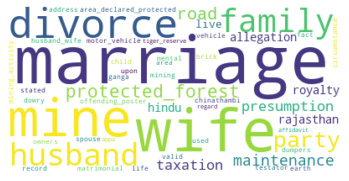

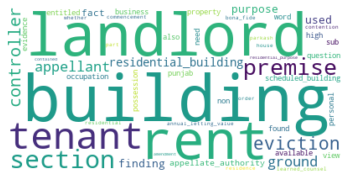

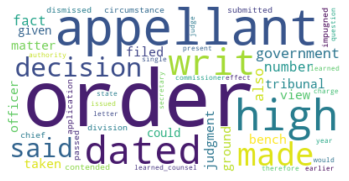

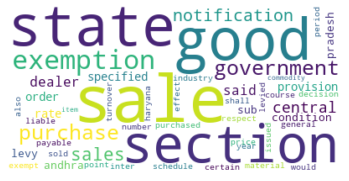

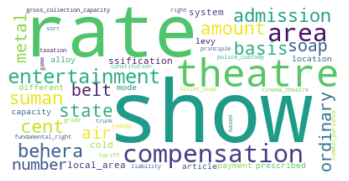

...

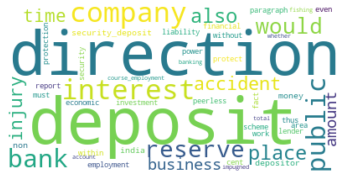

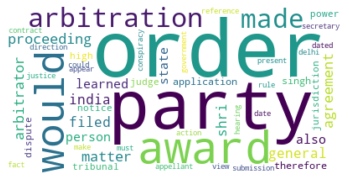

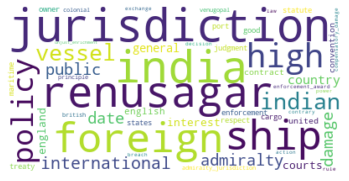

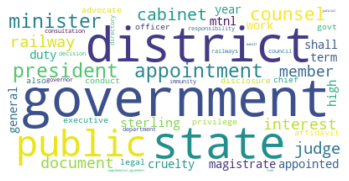

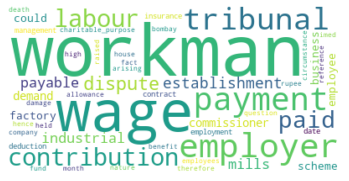

In [ ]:
from wordcloud import WordCloud
topic = 0 # Initialize counter
while topic < 15:
    # Get topics and frequencies and store in a dictionary structure
    topic_words_freq = dict(lda_model.show_topic(topic, topn=50)) # NB. the 'dict()' constructor builds dictionaries from sequences (lists) of key-value pairs - this is needed as input for the 'generate_from_frequencies' word cloud function
    topic += 1
    
    # Generate Word Cloud for topic using frequencies
    wordcloud = WordCloud(background_color="white").generate_from_frequencies(topic_words_freq) 
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()